# 1. Install 7z and extract datasets

In [3]:
# Install 7z
!apt-get install -y p7zip

# Extract datasets
!7z x -y MAXZEGA.7z
!7z x -y IZ0CVY.7z
!7z x -y SV2HWM.7z
#!7z x -y IU8QAI.7z

### Merge all datasets in a huge one
## Currently not used
##!if [ ! -f MERGED.csv ]; then cp MAXZEGA.csv MERGED.csv; tail -n +2 IZ0CVY.csv >> MERGED.csv; tail -n +2 SV2HWM.csv >> MERGED.csv; fi

Reading package lists... Done
Building dependency tree       
Reading state information... Done
p7zip is already the newest version (16.02+dfsg-6).
0 upgraded, 0 newly installed, 0 to remove and 39 not upgraded.

7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.20GHz (406F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Sca        1 file, 95857562 bytes (92 MiB)

Extracting archive: MAXZEGA.7z
--
Path = MAXZEGA.7z
Type = 7z
Physical Size = 95857562
Headers Size = 130
Method = BZip2
Solid = -
Blocks = 1

      2% - MAXZEGA.c                  4% - MAXZEGA.c                  6% - MAXZEGA.c                  8% - MAXZEGA.c                 11% - MAXZEGA.c                 13% - MAXZEGA.c                 15% - MAXZEGA.c                 17% - MAXZEGA.c                 20% - MAXZEGA.c                 22% - MAXZEGA.c                 25% - MAXZEGA.c                 27% - MA

# 2. Import the dataset and load libraries

In [1]:
# Set the station callsign
CALLSIGN = "IZ0CVY"

# Import libraries
import numpy as np
import seaborn as sn
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.pyplot import figure
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits import mplot3d
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# df = pd.read_csv('/content/' + CALLSIGN + '.csv', sep=';')
CURPATH = "/content"
CURPATH = "/home/jovyan/work/logs/IZ0CVY/fullogs"
df = pd.read_csv(CURPATH + "/" + CALLSIGN + '.csv', sep=';')

# Ignore strong signals to avoid biases
df = df.query("(snr > 0) | (snr < 70)")

# Remove unused (test) columns
df = df.drop('tx_pow', axis='columns')
df = df.drop('rec_pow', axis='columns')

## 2.1 Check the dataset format

In [2]:
df.head(10)

,latitude,longitude,altitude,elevation,azimuth,distance,snr,vel_v,vel_h,heading,temp,humidity,burst_timer
0,41.04255,13.64955,6870.9,1.44,142.99,174.0,8.4,-7.0,31.7,127.3,-273.0,-1.0,-1.0
1,41.04238,13.64985,6864.4,1.44,142.98,174.0,7.5,-6.8,31.3,126.1,-273.0,-1.0,-1.0
2,41.04222,13.65014,6857.8,1.43,142.98,174.1,7.5,-6.5,30.2,125.5,-273.0,-1.0,-1.0
3,41.04206,13.65043,6851.1,1.43,142.98,174.1,7.7,-7.1,29.6,126.7,-273.0,-1.0,-1.0
4,41.04173,13.65098,6837.8,1.43,142.97,174.2,7.3,-7.0,29.5,129.0,-273.0,-1.0,-1.0
5,41.67285,12.47723,1615.7,0.91,175.08,69.8,13.7,5.6,14.4,102.1,-273.0,-1.0,-1.0
6,41.67282,12.47738,1620.8,0.91,175.07,69.8,12.8,5.8,11.8,105.5,-273.0,-1.0,-1.0
7,41.67280,12.47751,1626.6,0.91,175.06,69.8,13.9,6.4,10.0,100.5,-273.0,-1.0,-1.0
8,41.67279,12.47762,1632.5,0.92,175.05,69.8,13.9,5.4,9.4,88.5,-273.0,-1.0,-1.0
9,41.67281,12.47774,1636.8,0.92,175.05,69.8,12.5,4.7,9.5,74.7,-273.0,-1.0,-1.0


## 2.2 Check the dataset initial statistics

In [5]:
df.describe()

,latitude,longitude,altitude,elevation,azimuth,distance,snr,vel_v,vel_h,heading,temp,humidity,burst_timer
count,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06
mean,4.177035e+01,1.295481e+01,1.781598e+04,9.696972e+00,1.511424e+02,1.176827e+02,1.896516e+01,2.138200e-01,1.659990e+01,1.406110e+02,-4.730668e+01,1.271648e+01,5.971030e-01
std,8.011265e-01,8.655893e-01,9.479105e+03,7.366231e+00,4.700365e+01,7.153582e+01,4.565435e+00,1.037528e+01,1.158022e+01,8.141628e+01,2.955356e+01,2.170625e+01,1.494908e+01
min,3.792109e+01,8.449580e+00,3.800000e+02,1.100000e-01,0.000000e+00,8.500000e+00,2.800000e+00,-1.355000e+02,0.000000e+00,0.000000e+00,-2.730000e+02,-1.000000e+00,-1.000000e+00
25%,4.146011e+01,1.248843e+01,9.755700e+03,4.190000e+00,1.313300e+02,7.420000e+01,1.600000e+01,-4.000000e-01,8.300000e+00,8.280000e+01,-5.840000e+01,1.100000e+00,-1.000000e+00
50%,4.165167e+01,1.279676e+01,1.749200e+04,8.290000e+00,1.564900e+02,9.710000e+01,1.980000e+01,4.500000e+00,1.390000e+01,1.125000e+02,-5.320000e+01,1.800000e+00,-1.000000e+00
75%,4.184738e+01,1.323182e+01,2.551540e+04,1.314000e+01,1.748500e+02,1.290000e+02,2.240000e+01,5.500000e+00,2.190000e+01,1.875000e+02,-3.860000e+01,1.340000e+01,-1.000000e+00
max,4.622024e+01,1.850719e+01,3.841760e+04,8.118000e+01,3.600000e+02,5.562000e+02,3.720000e+01,8.880000e+01,1.088000e+02,3.600000e+02,3.160000e+01,1.000000e+02,8.471000e+02


# 3. Run preliminary analysis on the dataset

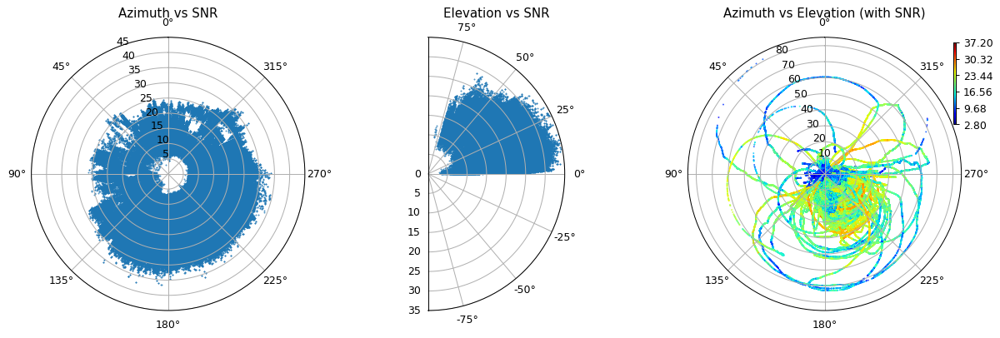

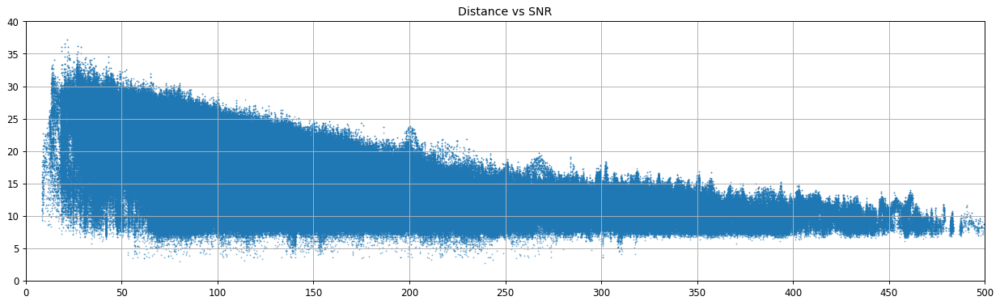

In [6]:
ddf = df

fig = plt.figure(figsize=(16, 16))
fig.set_dpi(90)

# AZIMUTH vs SNR
ax1 = plt.subplot(1,3,1, projection = 'polar')
ax1.set_theta_zero_location("N")
ax1.scatter(-np.deg2rad(ddf.azimuth), ddf.snr, s=0.2, cmap='jet')
plt.ylim(0, 45)
# ax1.set_xlabel('azimuth', fontsize = 20, labelpad = 20)
ax1.set_title('Azimuth vs SNR')

# ELEVATION vs SNR
ax2 = fig.add_subplot(1,3,2, projection='polar', xlim=(0, 90))
ax2.set_theta_zero_location("N")
ax2.set_thetamin(-90) # set the limits
ax2.set_thetamax(90)
ax2.set_theta_offset(np.deg2rad(0)) # point the origin towards the top
plt.ylim(0, 35)
# ax2.set_thetagrids(range(-90, 120, 30)) # set the gridlines
ax2.scatter(np.deg2rad(ddf.elevation), ddf.snr, s=0.2, cmap='jet')
# plt.ylim(0, 45)
ax2.set_title('Elevation vs SNR')

# AZIMUTH vs ELEVATION with SNR
ax3 = fig.add_subplot(1,3,3, projection='polar')
ax3.set_theta_zero_location("N")
# Create chart
plot = ax3.scatter(-np.deg2rad(ddf['azimuth']), ddf['elevation'], s=0.2, c=ddf['snr'], cmap='jet')
ax3.set_title('Azimuth vs Elevation (with SNR)')
# Create legend
cbaxes = inset_axes(ax3, width="1%", height="30%", loc=1)
plt.colorbar(plot, cax=cbaxes, orientation='vertical', ticks=np.linspace(ddf['snr'].min(), ddf['snr'].max(), 6))
# Show chart
plt.show()


# DISTANCE vs SNR
fig = plt.figure(figsize=(18, 5))
fig.set_dpi(85)
ax3 = fig.add_subplot(1,1,1)
plt.grid()
plt.scatter(ddf.distance, ddf.snr, s=0.1)
plt.xlim(0, 500)
plt.ylim(0, 40)
# ax3.set_xlabel('distance', fontsize = 20, labelpad = 20)
ax3.set_title('Distance vs SNR')
ax3.set_xticks(np.linspace(0,500,11))
plt.show()

# # produce a legend with the unique colors from the scatter
# legend1 = ax.legend(*scatter.legend_elements(),
#                     loc="lower left", title="Classes")
# ax.add_artist(legend1)

# ax3 = fig.add_subplot(111, projection = '3d')
# # ax3.set_theta_zero_location("N")
# plot = ax3.scatter(ddf.distance, ddf.snr, s=0.2, cmap='jet')
# ax3.set_xlabel('distance', fontsize = 20, labelpad = 20)
# ax3.set_title('Distance vs snr')

# 4. Check the correlation matrix map

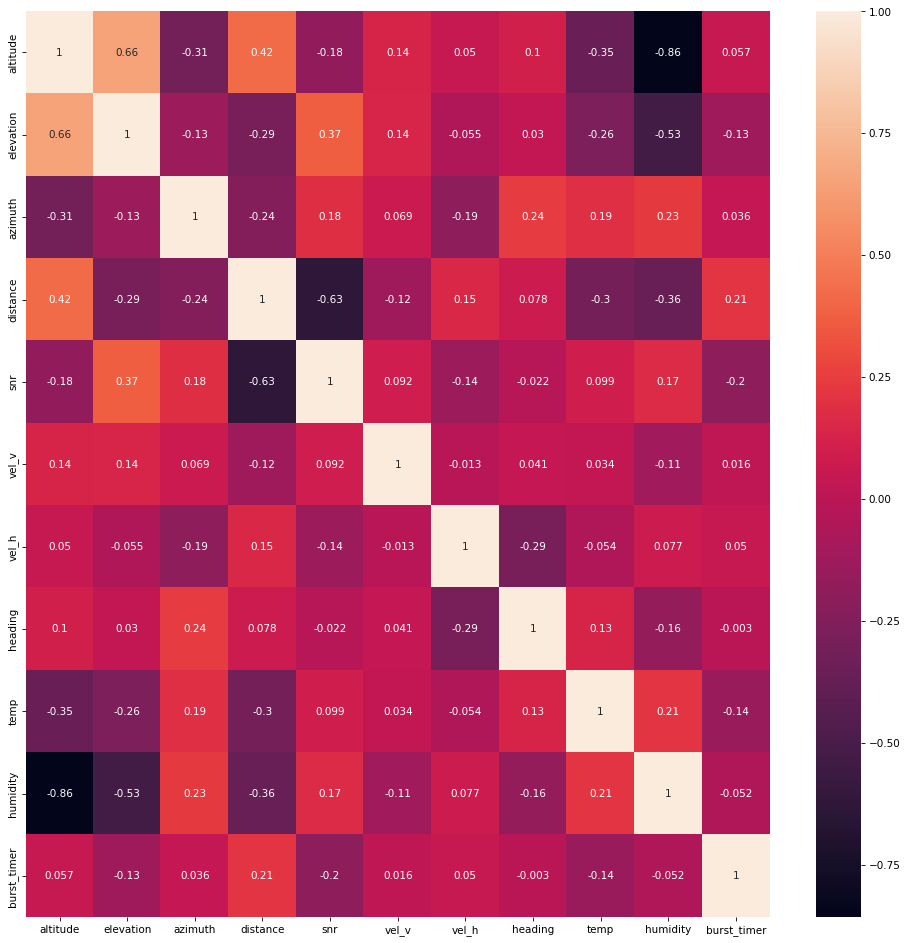

In [7]:
# Copy the dataframe, and drop unused columns
ddf = df
ddf = ddf.drop('latitude', axis='columns')
ddf = ddf.drop('longitude', axis='columns')
#ddf = ddf.drop('tx_pow', axis='columns')
#ddf = ddf.drop('rec_pow', axis='columns')
fig = plt.figure(figsize=(16, 16))
fig.set_dpi(75)

# Create the correlation matrix
corr_matrix = ddf.corr(method='spearman')
sn.heatmap(corr_matrix, annot=True)

# Show the correlation matrix
plt.show()

# 5. Calculate basic statistics of the data

In [8]:
# Copy the dataframe
ddf = df
ddf.describe()

,latitude,longitude,altitude,elevation,azimuth,distance,snr,vel_v,vel_h,heading,temp,humidity,burst_timer
count,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06,5.731520e+06
mean,4.177035e+01,1.295481e+01,1.781598e+04,9.696972e+00,1.511424e+02,1.176827e+02,1.896516e+01,2.138200e-01,1.659990e+01,1.406110e+02,-4.730668e+01,1.271648e+01,5.971030e-01
std,8.011265e-01,8.655893e-01,9.479105e+03,7.366231e+00,4.700365e+01,7.153582e+01,4.565435e+00,1.037528e+01,1.158022e+01,8.141628e+01,2.955356e+01,2.170625e+01,1.494908e+01
min,3.792109e+01,8.449580e+00,3.800000e+02,1.100000e-01,0.000000e+00,8.500000e+00,2.800000e+00,-1.355000e+02,0.000000e+00,0.000000e+00,-2.730000e+02,-1.000000e+00,-1.000000e+00
25%,4.146011e+01,1.248843e+01,9.755700e+03,4.190000e+00,1.313300e+02,7.420000e+01,1.600000e+01,-4.000000e-01,8.300000e+00,8.280000e+01,-5.840000e+01,1.100000e+00,-1.000000e+00
50%,4.165167e+01,1.279676e+01,1.749200e+04,8.290000e+00,1.564900e+02,9.710000e+01,1.980000e+01,4.500000e+00,1.390000e+01,1.125000e+02,-5.320000e+01,1.800000e+00,-1.000000e+00
75%,4.184738e+01,1.323182e+01,2.551540e+04,1.314000e+01,1.748500e+02,1.290000e+02,2.240000e+01,5.500000e+00,2.190000e+01,1.875000e+02,-3.860000e+01,1.340000e+01,-1.000000e+00
max,4.622024e+01,1.850719e+01,3.841760e+04,8.118000e+01,3.600000e+02,5.562000e+02,3.720000e+01,8.880000e+01,1.088000e+02,3.600000e+02,3.160000e+01,1.000000e+02,8.471000e+02


# 6. Generate pairplots

### Pairplots for altitude <= 14.000m

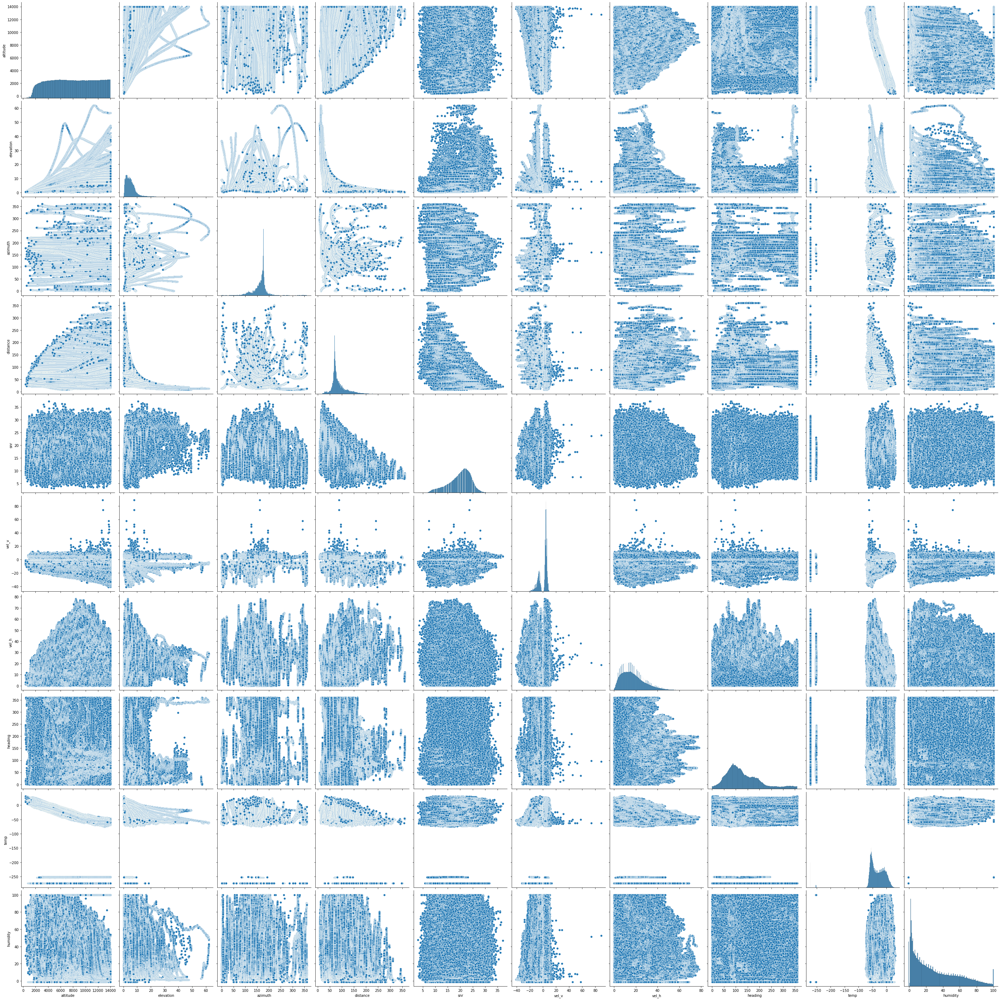

In [9]:
# Filter results to examine the lower atmosphere
ddf = df.query('altitude <= 14000')

## when running locally, limit the ram usage to avoid crashes.
#ddf = ddf.head(150000)
cols = ['altitude', 'elevation', 'azimuth', 'distance', 'snr', 'vel_v', 'vel_h', 'heading', 'temp', 'humidity']
sns_plot = sn.pairplot(ddf[cols], height=4.0)

sns_plot.savefig(CURPATH + "/sns_pairplot_" + CALLSIGN + "_14000-.png")

### Pairplots for altitude >= 20.000m

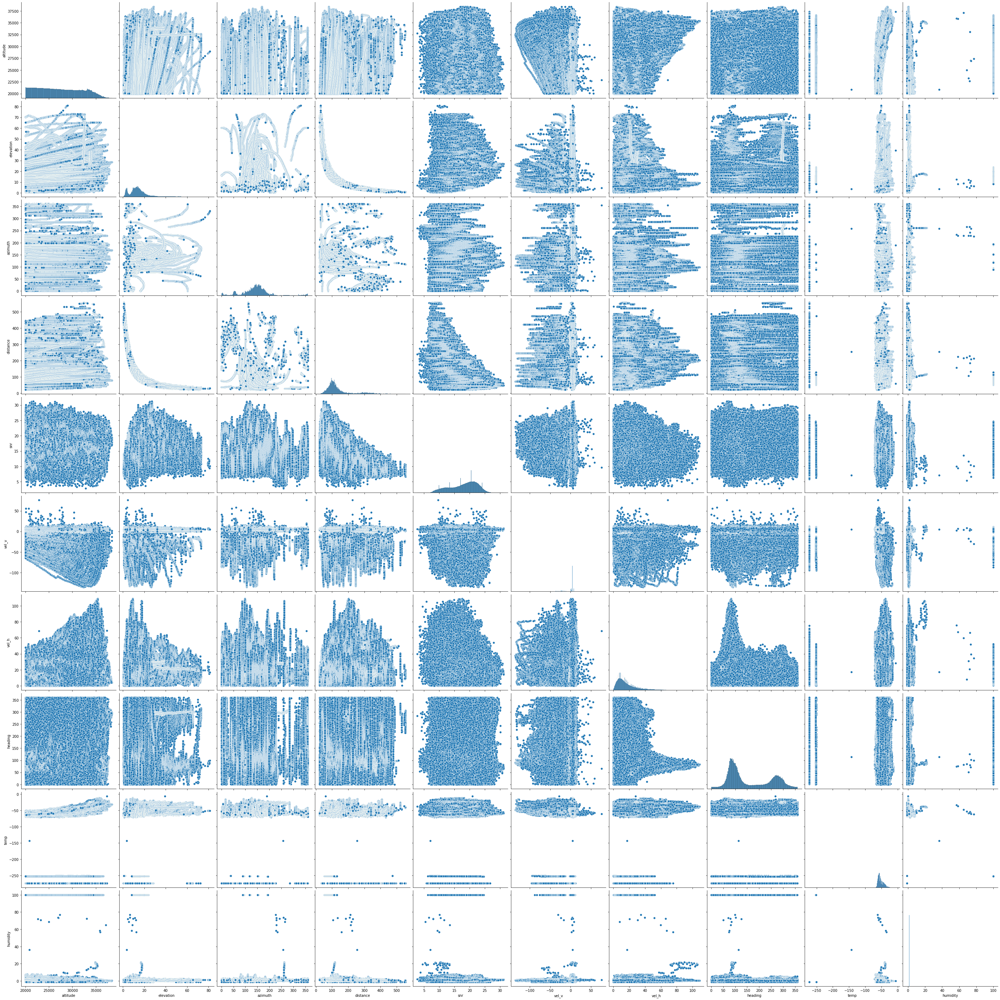

In [10]:
# Filter results to examine the higher atmosphere
ddf = df.query('altitude >= 20000')

## when running locally, limit the ram usage to avoid crashes.
#ddf = ddf.head(150000)
cols = ['altitude', 'elevation', 'azimuth', 'distance', 'snr', 'vel_v', 'vel_h', 'heading', 'temp', 'humidity']
sns_plot = sn.pairplot(ddf[cols], height=4.0)

sns_plot.savefig(CURPATH + "/sns_pairplot_" + CALLSIGN + "_20000+.png")

### Pairplot for all altitudes (full range)

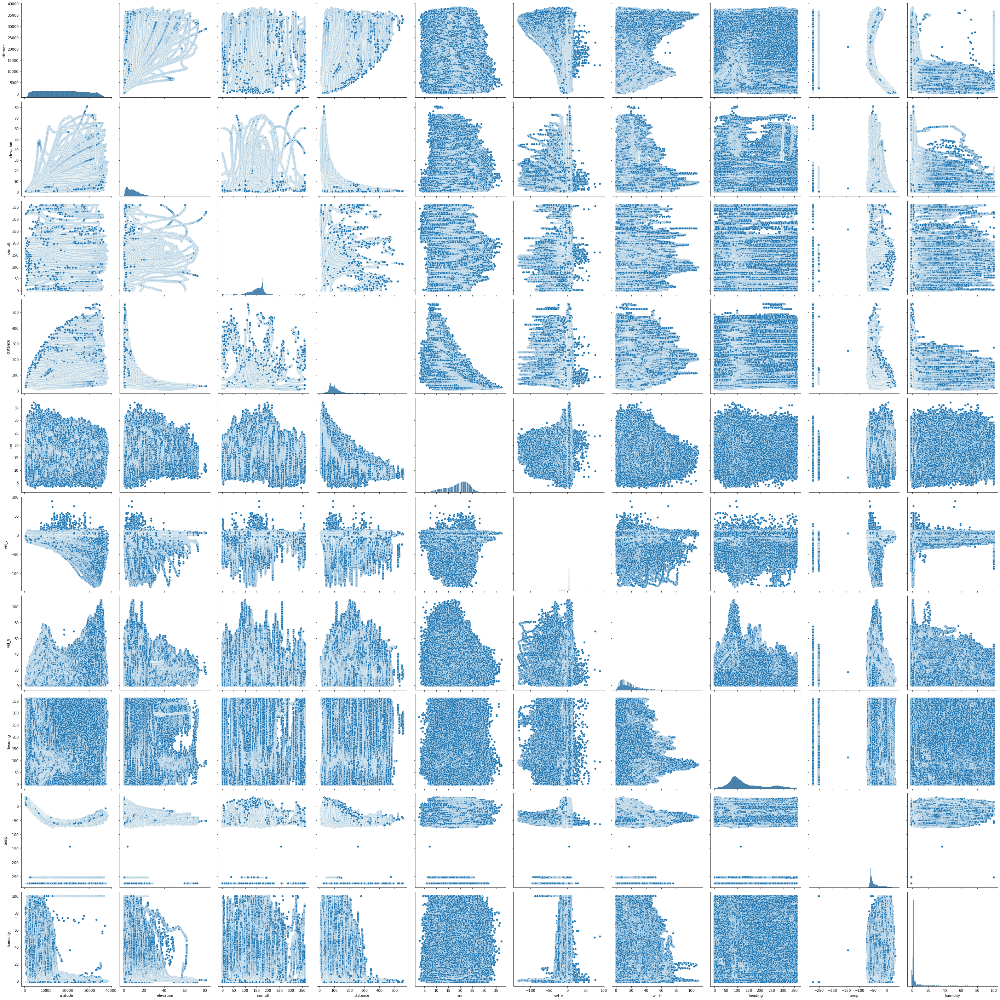

In [3]:
# Filter results to examine the lower atmosphere
ddf = df

## when running locally, limit the ram usage to avoid crashes.
#ddf = ddf.head(150000)
cols = ['altitude', 'elevation', 'azimuth', 'distance', 'snr', 'vel_v', 'vel_h', 'heading', 'temp', 'humidity']
sns_plot = sn.pairplot(ddf[cols], height=4.0)

sns_plot.savefig(CURPATH + "/sns_pairplot_" + CALLSIGN + "_fullrange.png")